In [1]:
import numpy as np
import pandas as pd
import calendar
from datetime import date
from datetime import datetime
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

# Q1

Create a single dataframe which will include following columns only

1. from the "crashes.csv", accident data (acc_dat), accident time (acc_time), weather description (weather_desc),report no, county (county_desc), latittude, and longitude
2. from the "persons.csv", gender, data of birth, and state code
3. from the "vehicles.csv", vehicle year, vehicle make, speed limit

Save your dataframe as a new csv file called "md_crash_2020.csv".

In [2]:
crashes = pd.read_csv('/Users/sravaniravulaparthi/Documents/Project1/crashes.csv',usecols = ['ACC_DATE','ACC_TIME','WEATHER_DESC','REPORT_NO','COUNTY_DESC','LATITUDE','LONGITUDE'], parse_dates=['ACC_DATE'])
persons = pd.read_csv('/Users/sravaniravulaparthi/Documents/Project1/persons.csv', usecols = ['SEX_DESC','DATE_OF_BIRTH','LICENSE_STATE_CODE','REPORT_NO'], parse_dates=['DATE_OF_BIRTH'])
vehicles = pd.read_csv('/Users/sravaniravulaparthi/Documents/Project1/vehicles.csv', usecols = ['VEH_YEAR','VEH_MAKE','SPEED_LIMIT','REPORT_NO'])

In [3]:
result = pd.merge(crashes,persons,on=['REPORT_NO','REPORT_NO'], how='outer')

In [4]:
final_data= pd.merge(result,vehicles,on=['REPORT_NO','REPORT_NO'], how='right')
final_data.head(100)

,COUNTY_DESC,REPORT_NO,WEATHER_DESC,ACC_DATE,ACC_TIME,LATITUDE,LONGITUDE,SEX_DESC,DATE_OF_BIRTH,LICENSE_STATE_CODE,VEH_YEAR,VEH_MAKE,SPEED_LIMIT
0,Baltimore,AE5057004X,Not Applicable,2020-05-28,11:40:00,39.245577,-76.702305,NaN,NaT,NaN,NaN,UNKNOWN,25
1,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1957-03-20,NaN,2018.0,TOYOTA,55
2,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Female,1969-10-01,MD,2018.0,TOYOTA,55
3,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Female,1965-10-05,NY,2018.0,TOYOTA,55
4,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1957-03-20,NaN,2018.0,TOYOTA,55
5,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1986-07-15,NH,2018.0,TOYOTA,55
6,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1962-01-01,MD,2018.0,TOYOTA,55
7,Prince George's,DA37010040,NaN,2020-06-09,16:05:00,38.879370,-76.896372,NaN,NaT,NaN,2019.0,CHEVROLET,30
8,Prince George's,DA37010040,NaN,2020-06-09,16:05:00,38.879370,-76.896372,Female,1988-09-10,MD,2019.0,CHEVROLET,30
9,Baltimore City,MDTA1791002C,NaN,2020-06-23,12:14:00,39.253400,-76.571600,NaN,NaT,NaN,NaN,UNKNOWN,35


In [5]:
csv_file = final_data.to_csv('md_crash_2020.csv')

# Q2

1. For each county, determine the average age of the drivers who were involved in these accidents
2. Then list the sorted averages (from youngest to oldest)

In [6]:
CurrentDate = date.today()

In [7]:
birth_year = final_data['DATE_OF_BIRTH'].dt.year

In [8]:
final_data['AGE_OF_PERSON'] = CurrentDate.year - birth_year

In [9]:
final_data['AGE_OF_PERSON'] = final_data['AGE_OF_PERSON'].fillna(0)

In [10]:
final_data['DATE_OF_BIRTH'] = final_data['DATE_OF_BIRTH'].fillna(0)

In [12]:
#1. For each county, determine the average age of the drivers who were involved in these accidents

avg_age = final_data.groupby(['COUNTY_DESC']).AGE_OF_PERSON.mean()
avg_age

COUNTY_DESC
Allegany           41.409399
Anne Arundel       37.302447
Baltimore          34.112577
Baltimore City     33.564852
Calvert            39.292953
Caroline           38.839275
Carroll            40.394534
Cecil              38.076281
Charles            36.829710
Dorchester         37.570222
Frederick          38.807262
Garrett            39.021212
Harford            39.599537
Howard             38.551048
Kent               40.922807
Montgomery         38.874928
Prince George's    34.412081
Queen Anne's       39.388497
Somerset           38.817797
St. Mary's         37.414225
Talbot             39.838137
Washington         38.437758
Wicomico           37.566238
Worcester          35.699838
Name: AGE_OF_PERSON, dtype: float64

In [13]:
#2. Then list the sorted averages (from youngest to oldest)

sorted_avg = avg_age.sort_values(ascending=True)
sorted_avg

COUNTY_DESC
Baltimore City     33.564852
Baltimore          34.112577
Prince George's    34.412081
Worcester          35.699838
Charles            36.829710
Anne Arundel       37.302447
St. Mary's         37.414225
Wicomico           37.566238
Dorchester         37.570222
Cecil              38.076281
Washington         38.437758
Howard             38.551048
Frederick          38.807262
Somerset           38.817797
Caroline           38.839275
Montgomery         38.874928
Garrett            39.021212
Calvert            39.292953
Queen Anne's       39.388497
Harford            39.599537
Talbot             39.838137
Carroll            40.394534
Kent               40.922807
Allegany           41.409399
Name: AGE_OF_PERSON, dtype: float64

# Q3

1. Determine the total number of crashes per "vehicle make". List the sorted values (e.g. Honda, 1234)
2. Determine average age of the car involved in these accidents for each "vehicle make".

In [14]:
#1. Determine the total number of crashes per "vehicle make". List the sorted values (e.g. Honda, 1234)

crashes_per_model = final_data.VEH_MAKE.value_counts()
crashes_per_model = crashes_per_model.sort_values(ascending=False)
crashes_per_model

FORD                    48632
HONDA                   41358
TOYOTA                  39721
NISSAN                  28066
UNKNOWN                 18940
DODGE                   15492
CHEVY                   14858
CHEVROLET               13924
HYUNDAI                 13912
JEEP                    11232
TOYT                    10321
CHEV                     9320
KIA                      8923
ACURA                    7544
GMC                      6640
HOND                     5975
BMW                      5845
LEXUS                    5361
NISS                     5188
MAZDA                    5169
HYUN                     4842
SUBARU                   4164
CHRYSLER                 3868
BUICK                    2737
MERCEDES                 2610
INFINITI                 2603
MERZ                     2291
AUDI                     2290
VOLKSWAGEN               2102
VOLVO                    2096
VOLK                     1874
DODG                     1837
VOLKSWAGON               1679
RAM       

In [15]:
final_data['VEH_YEAR'] = final_data['VEH_YEAR'].fillna(0)
final_data['VEH_YEAR'] = final_data['VEH_YEAR'].astype(int)

In [16]:
final_data.loc[final_data['VEH_YEAR'] == 0, 'AGE_CAR'] = 0

In [17]:
final_data['AGE_CAR'] = final_data['AGE_CAR'].fillna(CurrentDate.year - final_data['VEH_YEAR'])
final_data.head(100)

,COUNTY_DESC,REPORT_NO,WEATHER_DESC,ACC_DATE,ACC_TIME,LATITUDE,LONGITUDE,SEX_DESC,DATE_OF_BIRTH,LICENSE_STATE_CODE,VEH_YEAR,VEH_MAKE,SPEED_LIMIT,AGE_OF_PERSON,AGE_CAR
0,Baltimore,AE5057004X,Not Applicable,2020-05-28,11:40:00,39.245577,-76.702305,NaN,0,NaN,0,UNKNOWN,25,0.0,0.0
1,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1957-03-20 00:00:00,NaN,2018,TOYOTA,55,65.0,4.0
2,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Female,1969-10-01 00:00:00,MD,2018,TOYOTA,55,53.0,4.0
3,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Female,1965-10-05 00:00:00,NY,2018,TOYOTA,55,57.0,4.0
4,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1957-03-20 00:00:00,NaN,2018,TOYOTA,55,65.0,4.0
5,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1986-07-15 00:00:00,NH,2018,TOYOTA,55,36.0,4.0
6,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1962-01-01 00:00:00,MD,2018,TOYOTA,55,60.0,4.0
7,Prince George's,DA37010040,NaN,2020-06-09,16:05:00,38.879370,-76.896372,NaN,0,NaN,2019,CHEVROLET,30,0.0,3.0
8,Prince George's,DA37010040,NaN,2020-06-09,16:05:00,38.879370,-76.896372,Female,1988-09-10 00:00:00,MD,2019,CHEVROLET,30,34.0,3.0
9,Baltimore City,MDTA1791002C,NaN,2020-06-23,12:14:00,39.253400,-76.571600,NaN,0,NaN,0,UNKNOWN,35,0.0,0.0


In [18]:
#2. Determine average age of the car involved in these accidents for each "vehicle make".

avg_age_car = pd.DataFrame(final_data.groupby(['VEH_MAKE']).mean(), columns = ['AGE_CAR'])
avg_age_car = avg_age_car.rename(columns={'AGE_CAR':'Average_Age_Per_Make'})
avg_age_car.sort_index(ascending=False)

,Average_Age_Per_Make
VEH_MAKE,
`BUIC,21.000000
ZHEJIANG TAOTAO VEH.,0.000000
ZHEJIANG,3.000000
ZERO,2.000000
YY 150 TS,16.000000
YV4BZ982X91060431,13.000000
YV1SZ58D411016615,21.000000
YV1RS61R912084420,21.000000
YV1LS5572W1510082,24.000000


# Q4

1. Determine all the accidents that happened in a circle centered at (39.016149, -77.117942) with a radius of 5 km. Among them,
2. Determine the number of accidents where the speed limit was above 51 miles per hour.
3. Determine the number of accidents where the speed limit was below 41 miles per hour.

For this question alone, I'm creating a new dataframe from the "final_data" dataframe but with only unique "REPORT_NO" values. Unlike in the "final_data" where there are multiple rows with the same "REPORT_NO" with different values in other columns. "REPORT_NO" is assigned for the accident not for the number of cars and people involved, so considering unique "REPORT_NO" for the total number of accidents happened. 
Using this data only for this question.

In [19]:
df = final_data.groupby(['REPORT_NO','LATITUDE','LONGITUDE','SPEED_LIMIT']).size().reset_index(name='Count')
df.head(10)

,REPORT_NO,LATITUDE,LONGITUDE,SPEED_LIMIT,Count
0,AA0020000Y,39.515492,-76.178302,30,6
1,AA0020000Z,39.535022,-76.167839,40,1
2,AA00200010,39.526995,-76.171014,30,2
3,AA00200011,39.521119,-76.185048,30,4
4,AA00200012,39.522907,-76.184290,40,9
5,AA00200013,39.525076,-76.188968,40,4
6,AA00200016,39.527495,-76.171016,30,4
7,AA00400036,39.529816,-76.169732,30,8
8,AA00400038,39.508171,-76.164537,30,4
9,AA00400039,39.515582,-76.158624,20,3


In [20]:
from math import radians, sin, cos, acos
def haversine_distance(lat_1, lon_1, e_lat, e_lon):
        r = 6371.01
        phi1 = np.radians(lat_1)
        phi2 = np.radians(e_lat)
        delta_phi = np.radians(e_lat-lat_1)
        delta_lambda = np.radians(e_lon-lon_1)
        a = np.sin(delta_phi / 2)**2 + np.cos(phi1) * np.cos(phi2) *   np.sin(delta_lambda / 2)**2
        res = r * (2 * np.arctan2(np.sqrt(a), np.sqrt(1-a)))
        return np.round(res, 2)
df['Distance_from_C'] = df.apply(lambda x: haversine_distance(39.016149, -77.117942, x['LATITUDE'], x['LONGITUDE']), axis=1)
df.head(10)

,REPORT_NO,LATITUDE,LONGITUDE,SPEED_LIMIT,Count,Distance_from_C
0,AA0020000Y,39.515492,-76.178302,30,6,98.11
1,AA0020000Z,39.535022,-76.167839,40,1,100.08
2,AA00200010,39.526995,-76.171014,30,2,99.35
3,AA00200011,39.521119,-76.185048,30,4,97.99
4,AA00200012,39.522907,-76.184290,40,9,98.16
5,AA00200013,39.525076,-76.188968,40,4,97.97
6,AA00200016,39.527495,-76.171016,30,4,99.38
7,AA00400036,39.529816,-76.169732,30,8,99.62
8,AA00400038,39.508171,-76.164537,30,4,98.64
9,AA00400039,39.515582,-76.158624,20,3,99.52


In [21]:
#1. All the accidents that happend in a circle centered at (39.016149, -77.117942) with a radius of 5 km

accs_radius = df[df['Distance_from_C']<=5]
total_accs_5km = len(accs_radius['Distance_from_C'])
print("Accidents within 5km radis of circle centered at (39.016149, -77.117942) is :", total_accs_5km)

Accidents within 5km radis of circle centered at (39.016149, -77.117942) is : 1574


In [22]:
#2. Determine the number of accidents where the speed limit was above 51 miles per hour.

speed_limit_51 = accs_radius[accs_radius['SPEED_LIMIT']>51]
accs_at_51 = len(speed_limit_51)
print("No. of accidents where speed limit was above 51mph : ", accs_at_51)

No. of accidents where speed limit was above 51mph :  614


In [23]:
#3. Determine the number of accidents where the speed limit was below 41 miles per hour.

speed_limit_41 = accs_radius[accs_radius['SPEED_LIMIT']<41]
accs_at_41 = len(speed_limit_41)
print("No. of accidents where speed limit was below 41mph : ", accs_at_41)

No. of accidents where speed limit was below 41mph :  932


# Q5

1. Determine the number of drivers, who got in a car crash, from non-DMV states as a function of gender and list them
2. Normalize the previous list with number of male drivers and female drivers for each state.

In [24]:
driver_gender = pd.read_csv('/Users/sravaniravulaparthi/Documents/state_drivers.csv')

In [25]:
temp_df = final_data.copy()
temp_df = temp_df[temp_df['LICENSE_STATE_CODE'] != 'DC'][temp_df['LICENSE_STATE_CODE'] != 'MD'][temp_df['LICENSE_STATE_CODE'] != 'VA']

/var/folders/y2/3x85948x46v16htzdrvbgq7m0000gn/T/ipykernel_40215/557432520.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  temp_df = temp_df[temp_df['LICENSE_STATE_CODE'] != 'DC'][temp_df['LICENSE_STATE_CODE'] != 'MD'][temp_df['LICENSE_STATE_CODE'] != 'VA']


In [26]:
us_state_to_abbrev = {
    "Alabama": "AL",
    "Alaska": "AK",
    "Arizona": "AZ",
    "Arkansas": "AR",
    "California": "CA",
    "Colorado": "CO",
    "Connecticut": "CT",
    "Delaware": "DE",
    "Florida": "FL",
    "Georgia": "GA",
    "Hawaii": "HI",
    "Idaho": "ID",
    "Illinois": "IL",
    "Indiana": "IN",
    "Iowa": "IA",
    "Kansas": "KS",
    "Kentucky": "KY",
    "Louisiana": "LA",
    "Maine": "ME",
    "Maryland": "MD",
    "Massachusetts": "MA",
    "Michigan": "MI",
    "Minnesota": "MN",
    "Mississippi": "MS",
    "Missouri": "MO",
    "Montana": "MT",
    "Nebraska": "NE",
    "Nevada": "NV",
    "New Hampshire": "NH",
    "New Jersey": "NJ",
    "New Mexico": "NM",
    "New York": "NY",
    "North Carolina": "NC",
    "North Dakota": "ND",
    "Ohio": "OH",
    "Oklahoma": "OK",
    "Oregon": "OR",
    "Pennsylvania": "PA",
    "Rhode Island": "RI",
    "South Carolina": "SC",
    "South Dakota": "SD",
    "Tennessee": "TN",
    "Texas": "TX",
    "Utah": "UT",
    "Vermont": "VT",
    "Virginia": "VA",
    "Washington": "WA",
    "West Virginia": "WV",
    "Wisconsin": "WI",
    "Wyoming": "WY",
    "Dist. of Col.": "DC",
    "American Samoa": "AS",
    "Guam": "GU",
    "Northern Mariana Islands": "MP",
    "Puerto Rico": "PR",
    "United States Minor Outlying Islands": "UM",
    "U.S. Virgin Islands": "VI",
}

In [27]:
driver_gender['LICENSE_STATE_CODE'] = driver_gender.STATE.map(us_state_to_abbrev)

In [28]:
driver_gender.head()

,STATE,MALE,FEMALE,LICENSE_STATE_CODE
0,Alabama,"1,896,942","2,010,096",AL
1,Alaska,"251,993","281,234",AK
2,Arizona,"2,502,985","2,475,777",AZ
3,Arkansas,"1,041,548","1,078,030",AR
4,California,"12,968,614","12,564,306",CA


In [29]:
data_merge = pd.merge(driver_gender,temp_df, on='LICENSE_STATE_CODE')

In [30]:
#1. Determine the number of drivers, who got in a car crash, from non-DMV states

frame1 = data_merge.groupby(['LICENSE_STATE_CODE','MALE','FEMALE']).size().reset_index(name='Count')
frame1

,LICENSE_STATE_CODE,MALE,FEMALE,Count
0,AK,"251,993","281,234",49
1,AL,"1,896,942","2,010,096",108
2,AR,"1,041,548","1,078,030",60
3,AZ,"2,502,985","2,475,777",190
4,CA,"12,968,614","12,564,306",514
5,CO,"2,037,265","1,937,256",148
6,CT,"1,267,221","1,299,452",243
7,DE,"360,931","381,593",2851
8,FL,"6,988,162","7,274,553",1704
9,GA,"3,292,710","3,613,481",715


In [34]:
frame1['FEMALE'] = frame1['FEMALE'].str.replace(",","")
frame1['MALE'] = frame1['MALE'].str.replace(",","")

In [35]:
frame1.head()

,LICENSE_STATE_CODE,MALE,FEMALE,Count
0,AK,251993,281234,49
1,AL,1896942,2010096,108
2,AR,1041548,1078030,60
3,AZ,2502985,2475777,190
4,CA,12968614,12564306,514


In [36]:
female_drives = frame1['FEMALE'].sum()
male_drives = frame1['MALE'].sum()

In [37]:
print("Total number of female drivers involved in car crashes from non-DMV states is :\n ",female_drives)

Total number of female drivers involved in car crashes from non-DMV states is :
  28123420100961078030247577712564306193725612994523815937274553361348143924411235615645694290785227597310246161531426174010825676125158303628102166805521646431044646384207369072026134569490753575931455987369668970516000010408370113451581423867450601538091719138053230132408533805524194450527593726668682101848588134206651


In [38]:
print("Total number of male involved in car crashes from non-DMV states drivers is :\n ", male_drives)

Total number of male involved in car crashes from non-DMV states drivers is :
  2519931896942104154825029851296861420372651267221360931698816232927104705531100569570440417140821918751004041148984016169832473050504049347638216833752048659943750397220346990128368269939453900730337207308169384605689829383973812765751384681443695236455317700193326942212868782463596905927286228492662092911579212215799


In [39]:
#2. Normalize the previous list with number of male drivers and female drivers for each state.

from sklearn import preprocessing
import numpy as np
frame1_norm = frame1.copy()
[frame1_norm.MALE] = preprocessing.normalize([frame1_norm.MALE])
[frame1_norm.FEMALE] = preprocessing.normalize([frame1_norm.FEMALE])
frame1_norm = frame1_norm.rename(columns={'MALE':'NORM_MALE','FEMALE':'NORM_FEMALE'})
print("Normalized Data : \n")
frame1_norm

Normalized Data : 



,LICENSE_STATE_CODE,NORM_MALE,NORM_FEMALE,Count
0,AK,0.011522,0.012687,49
1,AL,0.086731,0.090681,108
2,AR,0.047621,0.048633,60
3,AZ,0.114441,0.111689,190
4,CA,0.592946,0.566811,514
5,CO,0.093147,0.087395,148
6,CT,0.057939,0.058622,243
7,DE,0.016502,0.017215,2851
8,FL,0.319510,0.328176,1704
9,GA,0.150548,0.163014,715


In [40]:
frame1_norm = frame1_norm.drop('Count', axis=1)

In [41]:
frame1 = frame1.drop('Count', axis=1)

# Q6

1. On which day of the week (Monday through Sunday) do the most of the crashes happen?
2. On which hour of the day (00 - 24) do the most of the crashes happen?

In [42]:
#1. On which day of the week (Monday through Sunday) do the most of the crashes happen?

final_data['ACC_DAY'] = final_data['ACC_DATE'].dt.day_name()

In [43]:
acc_day = final_data['ACC_DAY'].value_counts()
acc_day.set_index=0
acc_day

Friday       70007
Saturday     60293
Wednesday    59976
Thursday     59857
Monday       56851
Tuesday      55917
Sunday       49570
Name: ACC_DAY, dtype: int64

Most accidents happen on FRIDAY.

In [44]:
#2. On which hour of the day (00 - 24) do the most of the crashes happen?

final_data['ACC_HOUR'] = final_data['ACC_TIME'].astype('datetime64[ns]').dt.hour
acc_time = pd.DataFrame(final_data['ACC_HOUR'].value_counts(), index=None)
acc_time.index.names=['Accident_Hour']
acc_time.rename(columns={'ACC_HOUR':'Total_Accidents'})

,Total_Accidents
Accident_Hour,
17,34885
16,33802
15,33603
18,29209
14,28681
12,25320
13,24777
19,22190
11,20365


Most crashes happened at 17 hours.

# Q7

You need assume that it is a rainy/snowy day if the second column is bigger than 0.05 or if the third column is bigger than 1; otherwise take that day as a non-rainy/snowy day.

1. What is the ratio of the number of accidents happened in rainy/snowy days to the number of accidents happened in non-rainy/snowy days?

2. What does this ratio tell us?

In [45]:
rain_snow=pd.read_csv('/Users/sravaniravulaparthi/Documents/rain_snow.csv')
rain_snow.head()

,Date,Precip in.,Snow in.
0,1/1/2020,0.00,0
1,1/2/2020,0.00,0
2,1/3/2020,0.19,0
3,1/4/2020,0.21,0
4,1/5/2020,0.15,0


In [46]:
rain_snow['Rainy/Snowy'] = np.where((rain_snow['Precip in.'] > 0.05) | (rain_snow['Snow in.'] > 1), 'Rainy/Snowy', 'Non Rainy/Snowy')
rain_snow['Date'] = pd.to_datetime(rain_snow['Date'])
rain_snow['Year'] = pd.DatetimeIndex(rain_snow['Date']).year
rain_snow.head()

,Date,Precip in.,Snow in.,Rainy/Snowy,Year
0,2020-01-01,0.00,0,Non Rainy/Snowy,2020
1,2020-01-02,0.00,0,Non Rainy/Snowy,2020
2,2020-01-03,0.19,0,Rainy/Snowy,2020
3,2020-01-04,0.21,0,Rainy/Snowy,2020
4,2020-01-05,0.15,0,Rainy/Snowy,2020


In [47]:
df1 = final_data.copy()
df1.rename(columns={'ACC_DATE':'Date'}, inplace=True)
df1.head()

,COUNTY_DESC,REPORT_NO,WEATHER_DESC,Date,ACC_TIME,LATITUDE,LONGITUDE,SEX_DESC,DATE_OF_BIRTH,LICENSE_STATE_CODE,VEH_YEAR,VEH_MAKE,SPEED_LIMIT,AGE_OF_PERSON,AGE_CAR,ACC_DAY,ACC_HOUR
0,Baltimore,AE5057004X,Not Applicable,2020-05-28,11:40:00,39.245577,-76.702305,NaN,0,NaN,0,UNKNOWN,25,0.0,0.0,Thursday,11
1,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1957-03-20 00:00:00,NaN,2018,TOYOTA,55,65.0,4.0,Friday,12
2,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Female,1969-10-01 00:00:00,MD,2018,TOYOTA,55,53.0,4.0,Friday,12
3,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Female,1965-10-05 00:00:00,NY,2018,TOYOTA,55,57.0,4.0,Friday,12
4,Prince George's,MSP7221001P,NaN,2020-06-05,12:22:00,38.989139,-76.883444,Male,1957-03-20 00:00:00,NaN,2018,TOYOTA,55,65.0,4.0,Friday,12


In [48]:
merged_df = pd.merge(rain_snow, df1, on='Date', how='inner')
merged_df.head(500)

,Date,Precip in.,Snow in.,Rainy/Snowy,Year,COUNTY_DESC,REPORT_NO,WEATHER_DESC,ACC_TIME,LATITUDE,LONGITUDE,SEX_DESC,DATE_OF_BIRTH,LICENSE_STATE_CODE,VEH_YEAR,VEH_MAKE,SPEED_LIMIT,AGE_OF_PERSON,AGE_CAR,ACC_DAY,ACC_HOUR
0,2020-01-01,0.0,0,Non Rainy/Snowy,2020,Prince George's,BW0170002W,NaN,19:42:00,38.996493,-76.880143,Female,2009-11-21 00:00:00,NaN,0,UNKNOWN,35,13.0,0.0,Wednesday,19
1,2020-01-01,0.0,0,Non Rainy/Snowy,2020,Prince George's,BW0170002W,NaN,19:42:00,38.996493,-76.880143,Male,1990-04-10 00:00:00,MD,0,UNKNOWN,35,32.0,0.0,Wednesday,19
2,2020-01-01,0.0,0,Non Rainy/Snowy,2020,Prince George's,BW0170002W,NaN,19:42:00,38.996493,-76.880143,Female,1991-03-16 00:00:00,MD,0,UNKNOWN,35,31.0,0.0,Wednesday,19
3,2020-01-01,0.0,0,Non Rainy/Snowy,2020,Prince George's,BW0170002W,NaN,19:42:00,38.996493,-76.880143,NaN,0,NaN,0,UNKNOWN,35,0.0,0.0,Wednesday,19
4,2020-01-01,0.0,0,Non Rainy/Snowy,2020,Anne Arundel,AB451800WC,NaN,17:49:00,38.958582,-76.500872,Male,1977-03-06 00:00:00,MD,2005,CHEVY,25,45.0,17.0,Wednesday,17
5,2020-01-01,0.0,0,Non Rainy/Snowy,2020,St. Mary's,ZR0354001F,NaN,16:56:00,38.238725,-76.541248,Female,1981-03-31 00:00:00,MD,2016,HYUNDAI,50,41.0,6.0,Wednesday,16
6,2020-01-01,0.0,0,Non Rainy/Snowy,2020,St. Mary's,ZR0354001F,NaN,16:56:00,38.238725,-76.541248,Female,1965-06-15 00:00:00,MD,2016,HYUNDAI,50,57.0,6.0,Wednesday,16
7,2020-01-01,0.0,0,Non Rainy/Snowy,2020,St. Mary's,ZR0354001F,NaN,16:56:00,38.238725,-76.541248,Female,2018-02-02 00:00:00,NaN,2016,HYUNDAI,50,4.0,6.0,Wednesday,16
8,2020-01-01,0.0,0,Non Rainy/Snowy,2020,Baltimore City,ADJ812001B,NaN,2:08:00,39.298801,-76.645456,Female,1986-05-06 00:00:00,MD,2016,HONDA,35,36.0,6.0,Wednesday,2
9,2020-01-01,0.0,0,Non Rainy/Snowy,2020,Wicomico,DE3160007D,NaN,1:50:00,38.368018,-75.609178,Female,1996-08-01 00:00:00,MD,2005,PONTIAC,0,26.0,17.0,Wednesday,1


In [49]:
ratio_df = merged_df.groupby(['Rainy/Snowy','REPORT_NO']).size().reset_index(name='Count')
ratio_df

,Rainy/Snowy,REPORT_NO,Count
0,Non Rainy/Snowy,AA0020000Y,6
1,Non Rainy/Snowy,AA00200010,2
2,Non Rainy/Snowy,AA00200012,9
3,Non Rainy/Snowy,AA00200013,4
4,Non Rainy/Snowy,AA00400036,8
5,Non Rainy/Snowy,AA00400039,9
6,Non Rainy/Snowy,AA0040003C,4
7,Non Rainy/Snowy,AA0040003D,8
8,Non Rainy/Snowy,AA0072003H,15
9,Non Rainy/Snowy,AA0072003L,8


In [50]:
accs_sum = ratio_df.groupby('Rainy/Snowy').size().reset_index(name='Count')
accs_sum

,Rainy/Snowy,Count
0,Non Rainy/Snowy,57967
1,Rainy/Snowy,36228


In [51]:
#1. What is the ratio of the number of accidents happened in rainy/snowy days to the number of accidents happened in non-rainy/snowy days?

Rainy_Snowy = accs_sum.loc[0,'Count']
Non_Rainy_Snowy = accs_sum.loc[1, 'Count']
final_ratio = Rainy_Snowy/Non_Rainy_Snowy 
print('Ratio of crashes happend on Rainy/Snowy days to non Rainy/Snowy days is: ',final_ratio)

Ratio of crashes happend on Rainy/Snowy days to non Rainy/Snowy days is:  1.6000607265098818


#2 What does this ratio tell us?

It tells us that the crashes happened on Rainy/Snowy days(57967) are 1.6000607265098818 times more than the crashes that happened on non Rainy/Snowy days(36228).

# Q8

Use matplotlib and/or seaborn and show your talent in data visualization. You are free to visualize anything you want regarding this dataset.



Text(0.5, 1.0, 'Total number of accidents on each Day of the week')

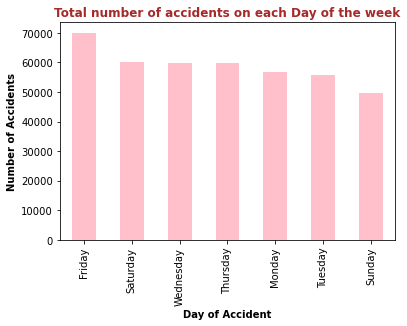

In [52]:
plot1 = acc_day.plot(kind='bar', color = 'pink')
plot1.set_xlabel('Day of Accident', fontweight='bold')
plot1.set_ylabel('Number of Accidents', fontweight='bold')
plot1.set_title("Total number of accidents on each Day of the week", fontweight='bold', color='brown')

In [53]:
pd_avg_age = pd.DataFrame(avg_age)
pd_avg_age = pd_avg_age.reset_index()

Text(0.5, 0, 'Average age of Person')

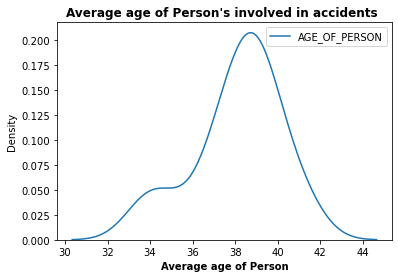

In [56]:
plot2 = sns.kdeplot( data=pd_avg_age)
plot2.set_title("Average age of Person's involved in accidents ", fontweight='bold' )
plot2.set_xlabel("Average age of Person", fontweight='bold')

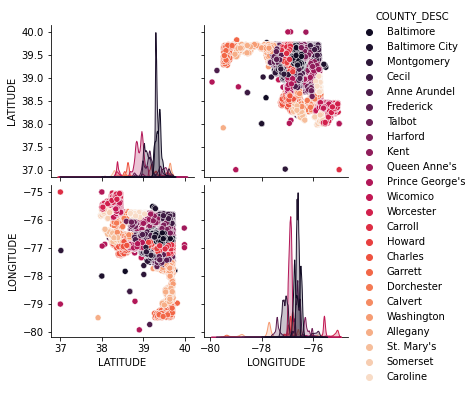

In [57]:
plot3 = sns.pairplot(crashes, hue='COUNTY_DESC', palette='rocket')

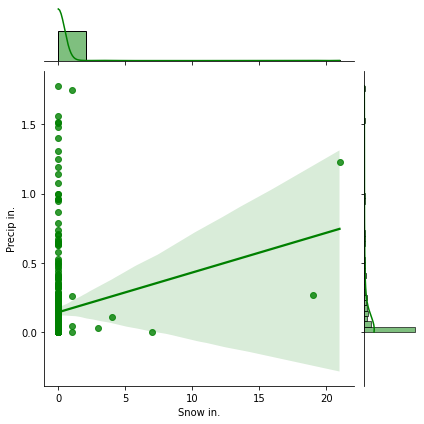

In [58]:
plot4 = sns.jointplot(x='Snow in.',y='Precip in.',data=rain_snow,kind='reg', color='green')

Text(0.5, 1.0, 'Number of accidents with respect to Speed limit and Age of the person')

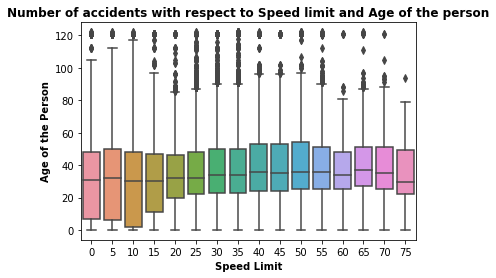

In [59]:
plot5 = sns.boxplot( x='SPEED_LIMIT',y='AGE_OF_PERSON',data=final_data)
plot5.set_xlabel('Speed Limit', fontweight='bold')
plot5.set_ylabel('Age of the Person', fontweight='bold')
plot5.set_title('Number of accidents with respect to Speed limit and Age of the person', fontweight='bold')

Text(0.5, 1.0, 'Number of accidents per Hour')

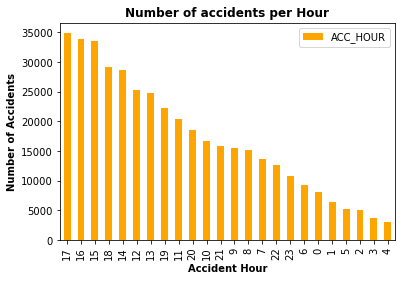

In [60]:
plot6 = acc_time.plot(kind='bar', color='orange')
plot6.set_xlabel('Accident Hour', fontweight='bold')
plot6.set_ylabel('Number of Accidents', fontweight='bold')
plot6.set_title('Number of accidents per Hour', fontweight='bold')

Text(0, 0.5, 'Age of the Person')

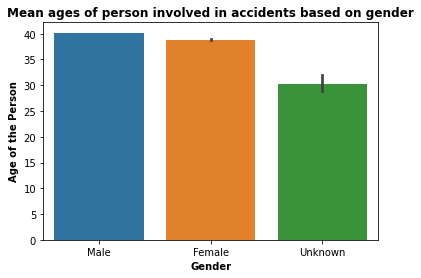

In [61]:
plot7  = sns.barplot(x='SEX_DESC', y='AGE_OF_PERSON', data=final_data, estimator = np.mean) 
plot7.set_title('Mean ages of person involved in accidents based on gender', fontweight='bold')
plot7.set_xlabel('Gender',fontweight='bold')
plot7.set_ylabel('Age of the Person',fontweight='bold')

In [62]:
index = frame1_norm['LICENSE_STATE_CODE']
frame1_norm.index = index

Text(0, 0.5, 'Normalized value')

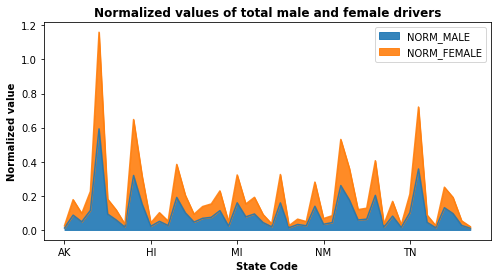

In [63]:
plot9 = frame1_norm.plot.area(figsize=[8,4],stacked=True, alpha=0.9)
plot9.set_title('Normalized values of total male and female drivers', fontweight='bold')
plot9.set_xlabel('State Code',fontweight='bold')
plot9.set_ylabel('Normalized value',fontweight='bold')

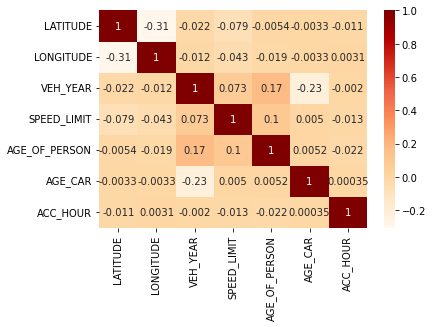

In [68]:
final_data_mx = final_data.corr()
plot10 = sns.heatmap(final_data_mx,annot=True, cmap='OrRd')